In [1]:
import numpy as np
import pandas as pd
from pathlib import Path

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
path_results = Path("../data/results/")

In [3]:
all_oof = dict(
    lightgbm = pd.read_csv(path_results / "oof_lightgbm_cv1.csv"),
    xgboost = pd.read_csv(path_results / "oof_xgboost_cv1.csv"),
    catboost = pd.read_csv(path_results / "oof_catboost_cv1.csv"),
    dt_nn = pd.read_csv(path_results / "oof_dt-nn_cv1.csv"),
    mlp = pd.read_csv(path_results / "oof_nn-mlp_cv1.csv"),
    gandalf = pd.read_csv(path_results / "oof_gandalf_cv1.csv"),
)

combined_df = all_oof["lightgbm"][["utility_agent1_true","fold"]]
for model, df in all_oof.items():
    combined_df[f'utility_agent1_pred_{model}'] = df['utility_agent1_pred']

combined_df = combined_df.dropna(subset=["fold"], ignore_index=True)
combined_df["fold"] = combined_df["fold"].astype(int)
combined_df

,utility_agent1_true,fold,utility_agent1_pred_lightgbm,utility_agent1_pred_xgboost,utility_agent1_pred_catboost,utility_agent1_pred_dt_nn,utility_agent1_pred_mlp,utility_agent1_pred_gandalf
0,-0.466667,2,-0.085834,-0.266970,-0.137153,-0.172795,0.085705,-0.409328
1,-0.333333,2,0.127977,0.370523,-0.031540,0.256416,0.155064,-0.128431
2,-0.066667,2,0.231497,0.121204,0.101627,0.149334,0.192855,-0.016309
3,-0.333333,2,0.032478,0.040438,0.029567,0.138708,0.158181,-0.154246
4,-0.333333,2,0.179910,0.481094,0.084618,0.228635,0.274969,0.051072
...,...,...,...,...,...,...,...,...
208603,-0.733333,1,-0.452967,-0.456596,-0.424561,-0.497529,-0.549524,-0.324641
208604,0.266667,1,-0.337590,-0.331496,-0.153953,-0.169544,0.022797,-0.336557
208605,0.666667,1,0.031267,-0.186448,-0.011900,-0.000092,0.395805,-0.053128
208606,0.666667,1,0.010582,-0.272336,0.025081,0.027810,0.325820,-0.162267


In [4]:
# Create a long-form DataFrame for plotting
melted_df = combined_df.melt(
    value_vars=[
        'utility_agent1_pred_lightgbm', 
        'utility_agent1_pred_xgboost', 
        'utility_agent1_pred_catboost',
        'utility_agent1_pred_dt_nn',
        #'utility_agent1_pred_mlp',
        'utility_agent1_pred_dt_nn',
        'utility_agent1_pred_mlp',
        'utility_agent1_pred_gandalf',
        'utility_agent1_true',

    ],
    var_name='Model',
    value_name='Utility Agent 1'
)

# Map model names for better labels
model_mapping = {
    'utility_agent1_pred_lightgbm': 'LightGBM',
    'utility_agent1_pred_xgboost': 'XGBoost',
    'utility_agent1_pred_catboost': 'CatBoost',
    #'utility_agent1_pred_mlp': 'MLP',
    'utility_agent1_pred_dt_nn': 'DT-NN',
    'utility_agent1_pred_mlp': "MLP",
    'utility_agent1_pred_gandalf': 'gandalf',
    'utility_agent1_true': 'True Values'
}
melted_df['Model'] = melted_df['Model'].map(model_mapping)

# Create a distribution plot for each model's predictions using Plotly Express
fig = px.histogram(
    melted_df, 
    x='Utility Agent 1', 
    color='Model',
    histnorm='percent',
    opacity=0.66,
    nbins=100,
    title='Distribution of Predictions for Each Model',
    labels={'Utility Agent 1': 'Utility Agent 1'}
)

fig.update_layout(
    barmode='overlay',
    xaxis_title='Utility Agent 1',
    yaxis_title='Percent',
    legend_title='Model'
)
fig.show()


Correlation matrix between model predictions:
                              utility_agent1_pred_lightgbm  \
utility_agent1_pred_lightgbm                      1.000000   
utility_agent1_pred_xgboost                       0.901615   
utility_agent1_pred_catboost                      0.929747   
utility_agent1_pred_dt_nn                         0.846297   
utility_agent1_pred_mlp                           0.854089   
utility_agent1_pred_gandalf                       0.859392   

                              utility_agent1_pred_xgboost  \
utility_agent1_pred_lightgbm                     0.901615   
utility_agent1_pred_xgboost                      1.000000   
utility_agent1_pred_catboost                     0.916028   
utility_agent1_pred_dt_nn                        0.845488   
utility_agent1_pred_mlp                          0.853417   
utility_agent1_pred_gandalf                      0.863792   

                              utility_agent1_pred_catboost  \
utility_agent1_pred_lightgbm 

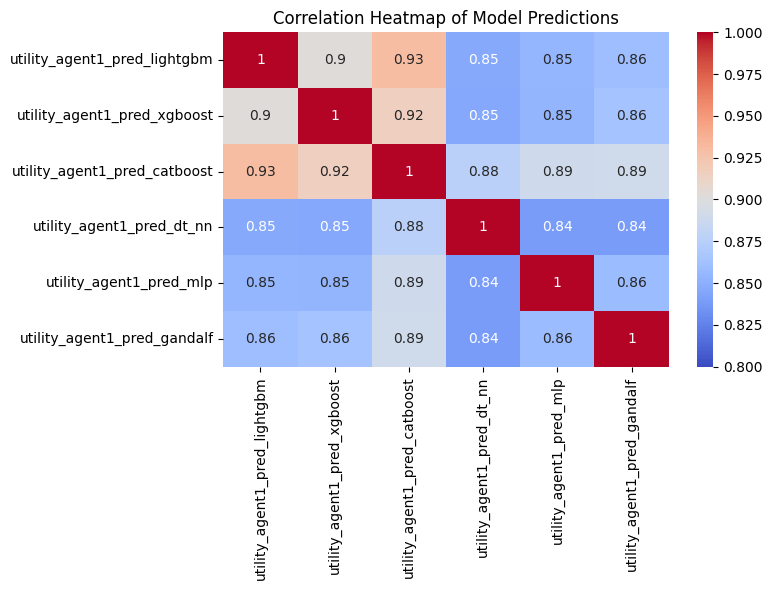


Correlation between true values and predictions:
utility_agent1_pred_lightgbm    0.649745
utility_agent1_pred_xgboost     0.650302
utility_agent1_pred_catboost    0.689986
utility_agent1_pred_dt_nn       0.640470
utility_agent1_pred_mlp         0.661711
utility_agent1_pred_gandalf     0.650715
Name: utility_agent1_true, dtype: float64


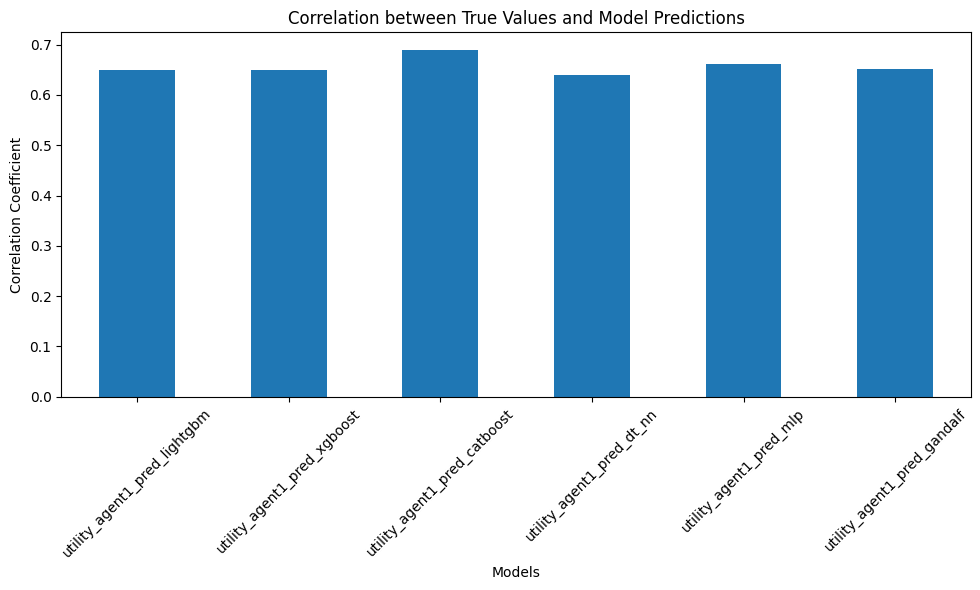

In [5]:
# Calculate correlation between model predictions
correlation_matrix = combined_df.filter(like='pred').corr()

# Display the correlation matrix
print("Correlation matrix between model predictions:")
print(correlation_matrix)

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=0.8, vmax=1)
plt.title('Correlation Heatmap of Model Predictions')
plt.tight_layout()
plt.show()

# Calculate correlation between true values and predictions
true_vs_pred_corr = combined_df.corr()['utility_agent1_true'].filter(like='pred')

print("\nCorrelation between true values and predictions:")
print(true_vs_pred_corr)

# Visualize the correlation between true values and predictions
plt.figure(figsize=(10, 6))
true_vs_pred_corr.plot(kind='bar')
plt.title('Correlation between True Values and Model Predictions')
plt.xlabel('Models')
plt.ylabel('Correlation Coefficient')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

***
## blend test

In [7]:
# Dictionary to store scores for each model
model_scores = {}

# Get all prediction columns
pred_columns = [col for col in combined_df.columns if 'pred' in col]

for model_col in pred_columns:
    scores = list()
    
    for _, df in combined_df.groupby("fold"):
        pred = df[model_col].clip(-1, 1)
        squared_errors = (df['utility_agent1_true'] - pred)**2
        rmse = np.sqrt(squared_errors.mean())
        scores.append(rmse)
        
    model_scores[model_col] = scores
    print(f"\n{model_col}:")
    print("Scores per fold:", [f"{score:.4f}" for score in scores])
    print("Average score: {:.4f}".format(np.mean(scores)))


utility_agent1_pred_lightgbm:
Scores per fold: ['0.4348', '0.4510', '0.4418', '0.4624', '0.4165']
Average score: 0.4413

utility_agent1_pred_xgboost:
Scores per fold: ['0.4450', '0.4582', '0.4527', '0.4468', '0.4102']
Average score: 0.4426

utility_agent1_pred_catboost:
Scores per fold: ['0.4173', '0.4303', '0.4191', '0.4363', '0.3972']
Average score: 0.4200

utility_agent1_pred_dt_nn:
Scores per fold: ['0.4343', '0.4611', '0.4574', '0.4538', '0.4244']
Average score: 0.4462

utility_agent1_pred_mlp:
Scores per fold: ['0.4361', '0.4509', '0.4512', '0.4518', '0.4124']
Average score: 0.4405

utility_agent1_pred_gandalf:
Scores per fold: ['0.4572', '0.4544', '0.4607', '0.4642', '0.4175']
Average score: 0.4508


In [17]:
# Create a linear blend of all predictions (excluding dt_nn)
pred_columns = [
    col for col in combined_df.columns
    if 'pred' in col 
    and 'dt_nn' not in col
]

# Function to calculate RMSE for given weights
def calculate_blend_rmse(weights, pred_cols, df):
    blended_predictions = np.zeros(len(df))
    for i, col in enumerate(pred_cols):
        blended_predictions += weights[i] * df[col].values
        
    scores = []
    for _, fold_df in df.groupby("fold"):
        fold_preds = blended_predictions[fold_df.index].clip(-1, 1)
        squared_errors = (fold_df['utility_agent1_true'] - fold_preds)**2
        rmse = np.sqrt(squared_errors.mean())
        scores.append(rmse)
    return np.mean(scores)

# Optimize weights using scipy
from scipy.optimize import minimize
from scipy.optimize import Bounds

# Initial weights - equal weights
initial_weights = np.ones(len(pred_columns)) / len(pred_columns)

# Constraint: weights sum to 1
def weight_constraint(weights):
    return np.sum(weights) - 1

constraints = {'type': 'eq', 'fun': weight_constraint}
bounds = Bounds(0, 1)  # Each weight between 0 and 1

# # Try different optimization methods
# methods = ['SLSQP', 'trust-constr', 'COBYLA']
# best_score = float('inf')
# best_result = None

# Optimize weights
result = minimize(
    lambda w: calculate_blend_rmse(w, pred_columns, combined_df),
    initial_weights,
    method='SLSQP',
    # method = 'trust-constr',
    # method = 'COBYLA',
    bounds=bounds,
    constraints=constraints
)

optimal_weights = result.x

# Calculate final blended predictions with optimal weights
blended_predictions = np.zeros(len(combined_df))
for i, col in enumerate(pred_columns):
    blended_predictions += optimal_weights[i] * combined_df[col].values

# Calculate and print final scores
blend_scores = []
for _, df in combined_df.groupby("fold"):
    fold_preds = blended_predictions[df.index].clip(-1, 1)
    squared_errors = (df['utility_agent1_true'] - fold_preds)**2
    rmse = np.sqrt(squared_errors.mean())
    blend_scores.append(rmse)

print("\nOptimized blend:")
print("Optimal weights:")
for col, weight in zip(pred_columns, optimal_weights):
    print(f"{col}: {weight:.4f}")
print("\nScores per fold:", [f"{score:.4f}" for score in blend_scores])
print("Average score: {:.4f}".format(np.mean(blend_scores)))


Optimized blend:
Optimal weights:
utility_agent1_pred_lightgbm: 0.0000
utility_agent1_pred_xgboost: 0.0424
utility_agent1_pred_catboost: 0.5826
utility_agent1_pred_mlp: 0.2382
utility_agent1_pred_gandalf: 0.1367

Scores per fold: ['0.4134', '0.4258', '0.4151', '0.4292', '0.3905']
Average score: 0.4148


In [33]:
from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, LassoCV, ElasticNetCV
from sklearn.svm import LinearSVR
from sklearn.ensemble import BaggingRegressor, ExtraTreesRegressor, GradientBoostingRegressor, RandomTreesEmbedding
 
# Create a linear blend of all predictions (excluding dt_nn) using sklearn LinearRegression
pred_columns = [
    col for col in combined_df.columns 
    if 'pred' in col
    and 'dt_nn' not in col
]

# Split data by fold and fit/predict on each fold
blend_scores = []
blended_predictions = np.zeros(len(combined_df))

for fold in combined_df['fold'].unique():
    # Split into train/test for this fold
    train_mask = combined_df['fold'] != fold
    test_mask = combined_df['fold'] == fold
    
    X_train = combined_df.loc[train_mask, pred_columns]
    y_train = combined_df.loc[train_mask, 'utility_agent1_true']
    X_test = combined_df.loc[test_mask, pred_columns]
    y_test = combined_df.loc[test_mask, 'utility_agent1_true']
    
    # Fit linear regression
    # lr = LinearRegression(positive=True)  # Enforce positive weights
    # lr = Ridge(positive=True)
    # lr = RidgeCV()
    # lr = LassoCV()
    # lr = ElasticNetCV()
    #lr = LinearSVR()
    lr = BaggingRegressor(n_estimators=100)
    lr.fit(X_train, y_train)
    
    # Make predictions
    fold_preds = lr.predict(X_test).clip(-1, 1)
    blended_predictions[test_mask] = fold_preds
    
    # Calculate score for this fold
    squared_errors = (y_test - fold_preds)**2
    rmse = np.sqrt(squared_errors.mean())
    blend_scores.append(rmse)

# Get final weights by fitting on all data
# lr_final = LinearRegression(positive=True)
# lr_final = RidgeCV()
# lr_final = LassoCV()
# lr_final = ElasticNetCV()
# lr_final = LinearSVR()

# lr_final.fit(combined_df[pred_columns], combined_df['utility_agent1_true'])
# optimal_weights = lr_final.coef_
# # Normalize weights to sum to 1
# optimal_weights = optimal_weights / np.sum(optimal_weights)

# print("\nOptimized blend:")
# print("Optimal weights:")
# for col, weight in zip(pred_columns, optimal_weights):
#     print(f"{col}: {weight:.4f}")

print("\nScores per fold:", [f"{score:.4f}" for score in blend_scores])
print("Average score: {:.4f}".format(np.mean(blend_scores)))


Scores per fold: ['0.4406', '0.4324', '0.4303', '0.4092', '0.4443']
Average score: 0.4314


***
## post-proc test


utility_agent1_pred_lightgbm:
Scores per fold: ['0.4348', '0.4510', '0.4418', '0.4624', '0.4165']
Average score: 0.4413

utility_agent1_pred_xgboost:
Scores per fold: ['0.4450', '0.4582', '0.4527', '0.4468', '0.4102']
Average score: 0.4426

utility_agent1_pred_catboost:
Scores per fold: ['0.4173', '0.4303', '0.4191', '0.4363', '0.3972']
Average score: 0.4200

utility_agent1_pred_dt_nn:
Scores per fold: ['0.4343', '0.4611', '0.4574', '0.4538', '0.4244']
Average score: 0.4462

utility_agent1_pred_mlp:
Scores per fold: ['0.4361', '0.4509', '0.4512', '0.4518', '0.4124']
Average score: 0.4405

utility_agent1_pred_gandalf:
Scores per fold: ['0.4572', '0.4544', '0.4607', '0.4642', '0.4175']
Average score: 0.4508


In [11]:
oof = pd.read_csv(path_results / "oof_catboost_cv1.csv")
oof = oof.dropna(subset=["fold"], ignore_index=True)
oof["fold"] = oof["fold"].astype(int)
oof

,utility_agent1_true,utility_agent1_pred,fold
0,-0.466667,-0.137153,2
1,-0.333333,-0.031540,2
2,-0.066667,0.101627,2
3,-0.333333,0.029567,2
4,-0.333333,0.084618,2
...,...,...,...
208603,-0.733333,-0.424561,1
208604,0.266667,-0.153953,1
208605,0.666667,-0.011900,1
208606,0.666667,0.025081,1


In [17]:
def compute_cv_score(oof_df):
    scores = list()
    for _, df in oof_df.groupby("fold"):
        pred = df["utility_agent1_pred"].clip(-1, 1)
        squared_errors = (df['utility_agent1_true'] - pred)**2
        rmse = np.sqrt(squared_errors.mean())
        scores.append(rmse)
    return np.mean(scores)

In [23]:
compute_cv_score(oof)

0.4200250872472802

In [24]:
_oof = oof.copy()

w = 1.1
shift=0
p_min = -0.985
p_max = 0.985

_oof["utility_agent1_pred"] = (_oof["utility_agent1_pred"] * w + shift).clip(p_min, p_max)

compute_cv_score(_oof)

0.42009927442299444